In [23]:
import numpy as np
import matplotlib.pyplot as plt
import os
import torch
%matplotlib inline

In [8]:
org_dir = "outputs/METR-LA/origin/id_data_METR-LA_ema_False_eps_0.001_mad_0.99_sit_300_/epoch"
wb_dir = "outputs/METR-LA/wavebound/id_data_METR-LA_ema_True_eps_1.0_mad_0.99_sit_5000_/epoch"

In [10]:
# true 
with open(os.path.join(org_dir, "true.npy"), 'rb') as f:
    y = np.load(f)
# org
with open(os.path.join(org_dir, "pred.npy"), 'rb') as f:
    org = np.load(f)
# wb
with open(os.path.join(wb_dir, "pred.npy"), 'rb') as f:
    wb = np.load(f)

In [12]:
y.shape, org.shape, wb.shape

((6850, 207, 12), (6850, 207, 12), (6850, 207, 12))

In [18]:
from util import metric

for i in range(12):
    org_metrics = metric(torch.Tensor(org[:, :, i]), torch.Tensor(y[:, :, i]))
    wb_metrics  = metric(torch.Tensor(wb[:, :, i]), torch.Tensor(y[:, :, i]))
    print(f"step {i} || org | MAE {org_metrics[0]:.4f} MAPE {org_metrics[1]:.4f} RMSE {org_metrics[2]:.4f} | ")
    print(f"step {i} || wb  | MAE {wb_metrics[0]:.4f} MAPE {wb_metrics[1]:.4f} RMSE {wb_metrics[2]:.4f} | ")

step 0 || org | MAE 2.2271 MAPE 0.0542 RMSE 3.8428 | 
step 0 || wb  | MAE 2.2142 MAPE 0.0533 RMSE 3.8332 | 
step 1 || org | MAE 2.5051 MAPE 0.0630 RMSE 4.6283 | 
step 1 || wb  | MAE 2.4883 MAPE 0.0625 RMSE 4.6079 | 
step 2 || org | MAE 2.6998 MAPE 0.0693 RMSE 5.1684 | 
step 2 || wb  | MAE 2.6703 MAPE 0.0691 RMSE 5.1104 | 
step 3 || org | MAE 2.8555 MAPE 0.0747 RMSE 5.5968 | 
step 3 || wb  | MAE 2.8136 MAPE 0.0747 RMSE 5.5052 | 
step 4 || org | MAE 2.9837 MAPE 0.0795 RMSE 5.9430 | 
step 4 || wb  | MAE 2.9306 MAPE 0.0792 RMSE 5.8260 | 
step 5 || org | MAE 3.0966 MAPE 0.0837 RMSE 6.2413 | 
step 5 || wb  | MAE 3.0312 MAPE 0.0832 RMSE 6.1046 | 
step 6 || org | MAE 3.2017 MAPE 0.0874 RMSE 6.5226 | 
step 6 || wb  | MAE 3.1207 MAPE 0.0866 RMSE 6.3449 | 
step 7 || org | MAE 3.2935 MAPE 0.0907 RMSE 6.7517 | 
step 7 || wb  | MAE 3.1991 MAPE 0.0895 RMSE 6.5446 | 
step 8 || org | MAE 3.3725 MAPE 0.0936 RMSE 6.9530 | 
step 8 || wb  | MAE 3.2676 MAPE 0.0921 RMSE 6.7180 | 
step 9 || org | MAE 3.4446 M

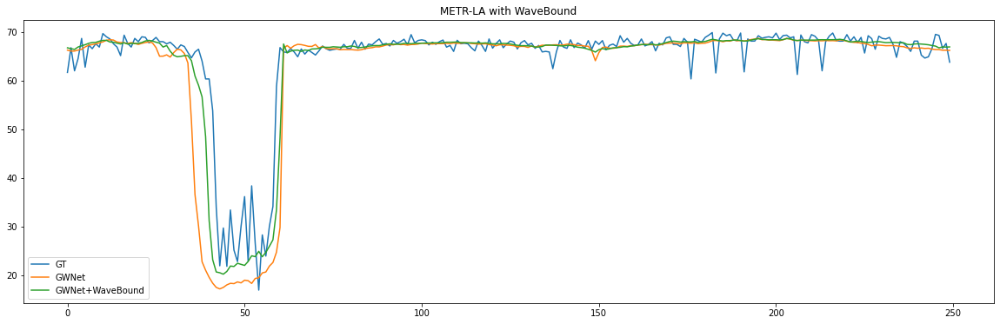

In [34]:
NODE = 2
step = 11
plt.figure(figsize=(20, 6))
s = 2000
e = 2250

plt.title(f"METR-LA with WaveBound")
plt.plot(y[s:e, NODE, step], label="GT")
plt.plot(org[s:e, NODE, step], label="GWNet")
plt.plot(wb[s:e, NODE, step], label="GWNet+WaveBound")
plt.legend()
plt.show()

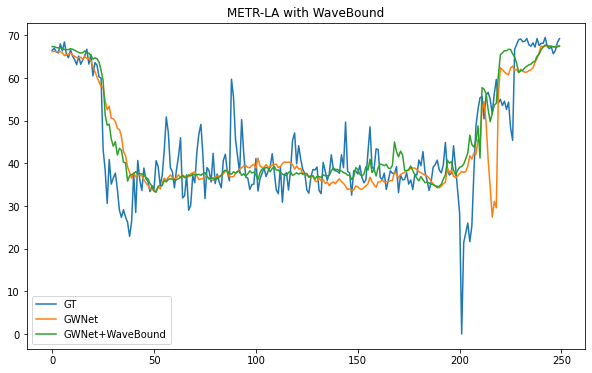

In [47]:
NODE = 15
step = 11
plt.figure(figsize=(10, 6))
s = 5500
e = 5750

plt.title(f"METR-LA with WaveBound")
plt.plot(y[s:e, NODE, step], label="GT")
plt.plot(org[s:e, NODE, step], label="GWNet")
plt.plot(wb[s:e, NODE, step], label="GWNet+WaveBound")
plt.legend()
plt.show()

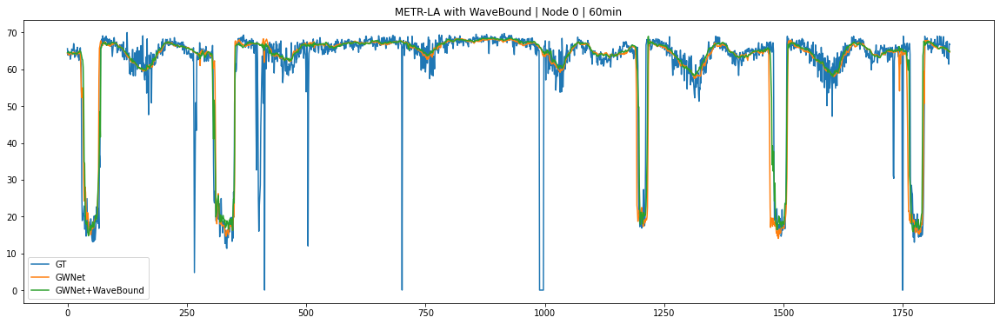

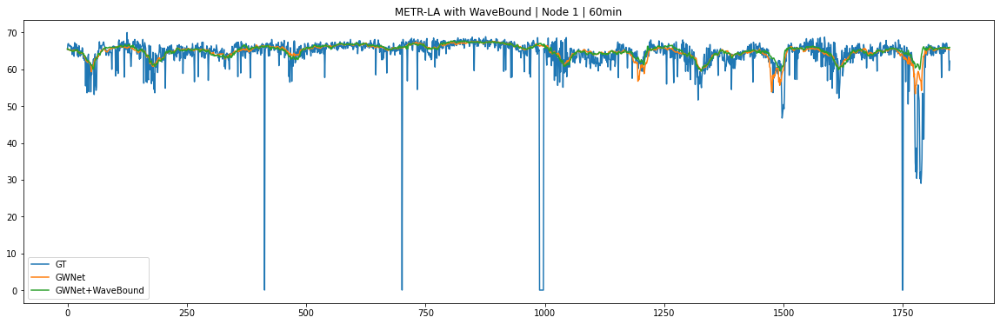

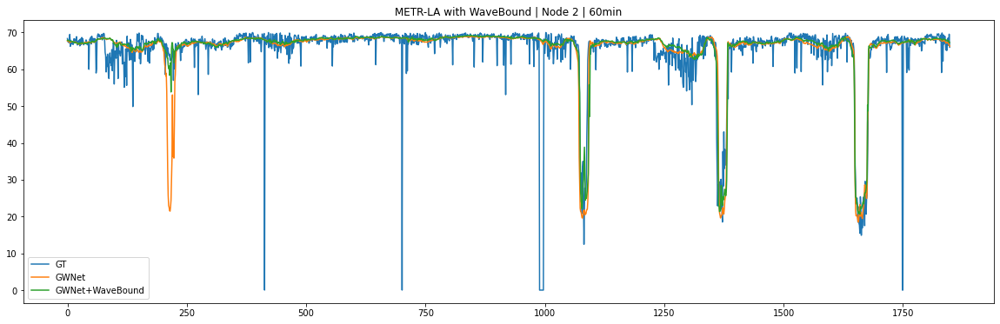

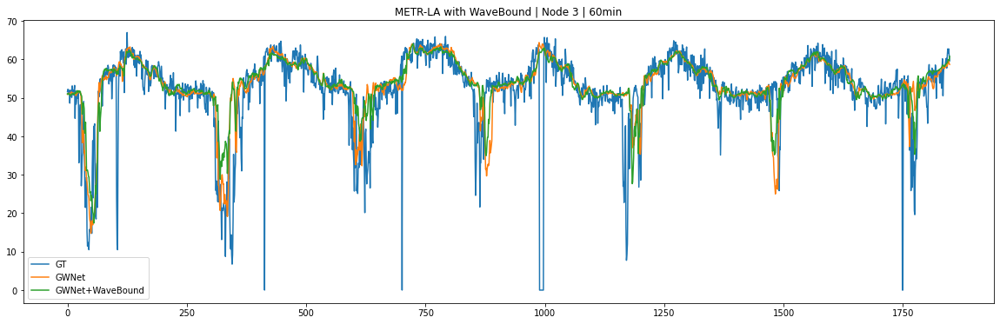

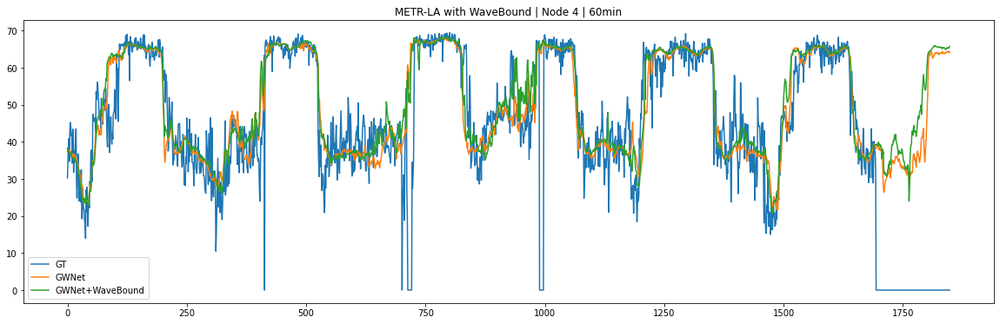

...

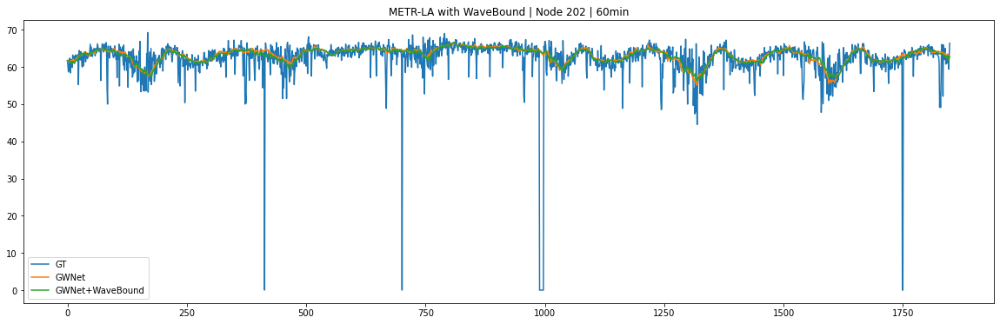

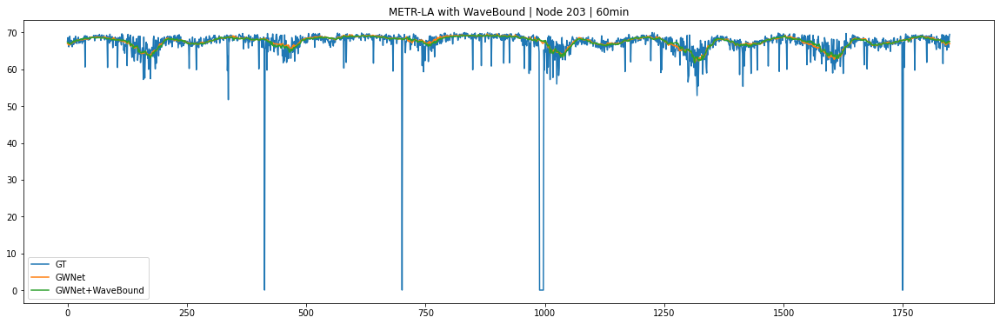

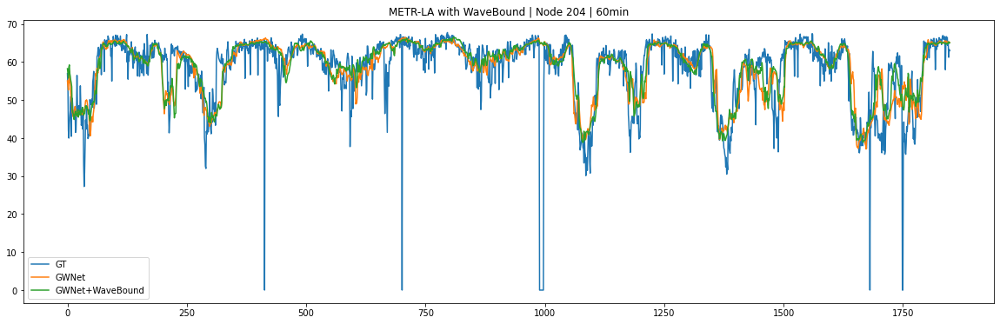

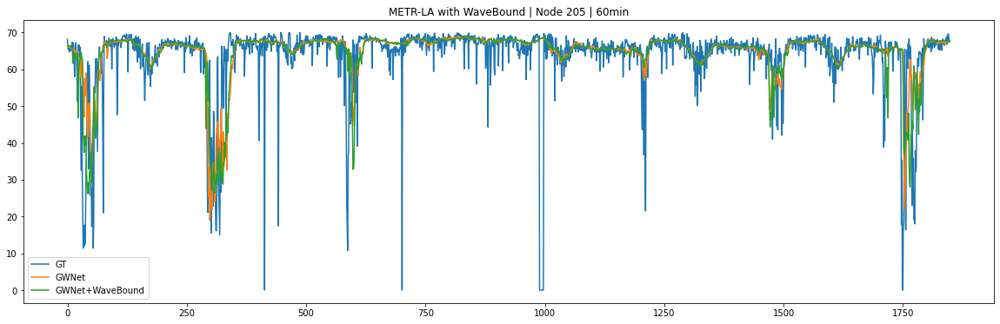

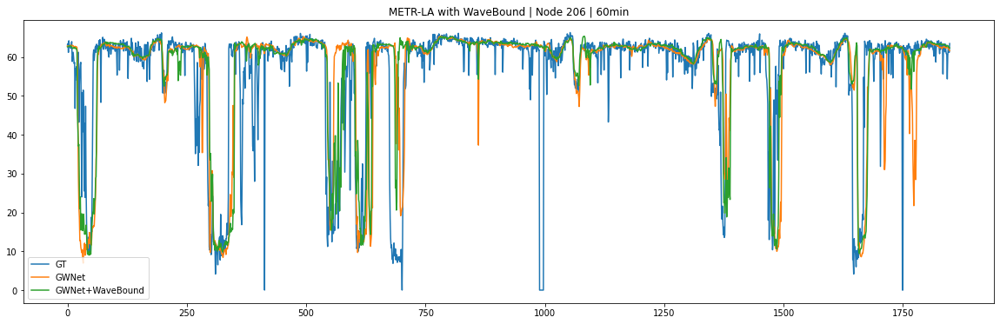

In [45]:
NODE = 2
step = 11

s = 5000#2000
e = -1#2250

for n in range(207):
    plt.figure(figsize=(20, 6))
    NODE = n
    plt.title(f"METR-LA with WaveBound | Node {NODE} | {(step+1)*5}min")
    plt.plot(y[s:e, NODE, step], label="GT")
    plt.plot(org[s:e, NODE, step], label="GWNet")
    plt.plot(wb[s:e, NODE, step], label="GWNet+WaveBound")
    plt.legend()
    plt.show()